
<h2 align="center" style="color:brown;font-size:200%">Lab 7: Image Compression Techniques</h2>

## **Introduction**

In today’s digital age, the growing demand for high-resolution and large-scale image storage and transmission presents significant challenges in terms of storage space and bandwidth limitations. Image compression is a solution to this problem, enabling efficient storage and faster transmission of images by reducing their file size without compromising on usability or perceived quality.

Image compression techniques fall into two broad categories: **lossless** and **lossy compression**. 
- Lossless methods preserve the original image data perfectly but often achieve lower compression ratios.
- In contrast, lossy techniques reduce file sizes significantly by discarding non-critical data, which may lead to some quality loss. Both approaches are widely applied in various fields, including web development, mobile applications, medical imaging, and multimedia streaming.

This report explores different image compression techniques by applying them to a chosen image and analyzing their performance using standard metrics such as **compression ratio**, **Mean Squared Error (MSE)**, and **Peak Signal-to-Noise Ratio (PSNR)**. Through this evaluation, we aim to identify the strengths and limitations of each technique and provide insights into selecting the most suitable method for specific use cases.


## **Problem Statement:**

- Digital images often occupy significant storage space, making them impractical for efficient storage and transmission. Uncompressed images require substantial bandwidth, which is a bottleneck in modern applications like streaming and cloud storage. Effective image compression techniques are necessary to reduce file sizes without compromising quality. 
- However, determining which compression method is optimal for a given application remains a challenge, as different techniques vary in compression efficiency, computational requirements, and the visual quality of the decompressed image.
- This project addresses the need to evaluate and compare the performance of different image compression methods on a given image using standard metrics.


## **Objectives:**
- To understand and implement various image compression techniques, including **lossless** and **lossy methods**.
- To analyze the effectiveness of these methods by applying them to a chosen image.
- To evaluate the performance of each compression technique using metrics such as **compression ratio**, **compression factor**, **Mean Squared Error (MSE)**, and **Peak Signal-to-Noise Ratio (PSNR)**.
- To compare and interpret the results to determine the most efficient compression method for specific use cases.
- To provide a comprehensive report detailing the results and conclusions drawn from the analysis.

In [9]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from heapq import heapify, heappop, heappush
import os

In [10]:
# Load the image
image = cv2.imread("image.png")
if image is None:
    raise ValueError(f"Image is not found.")

In [11]:
if len(image.shape) == 2:
    if np.unique(image).size <= 2:  # Only 0 and 1 for Binary
        print("Image is Binary")
    else:
        print("Image is Grayscale")
elif len(image.shape) == 3 and image.shape[2] == 3:
    print("Image is a Color Image")
    blue, green, red = cv2.split(image)  # OpenCV loads as BGR by default
    avg_blue = np.mean(blue)
    avg_green = np.mean(green)
    avg_red = np.mean(red)
    print(f"Channel Averages - Blue: {avg_blue}, Green: {avg_green}, Red: {avg_red}")
    if avg_red > avg_blue:
        print("Image is RGB")
    else:
        print("Image is BGR")
else:
    print("Image is Unknown")

Image is a Color Image
Channel Averages - Blue: 66.0778441661736, Green: 92.38919011545761, Red: 120.34458487314535
Image is RGB


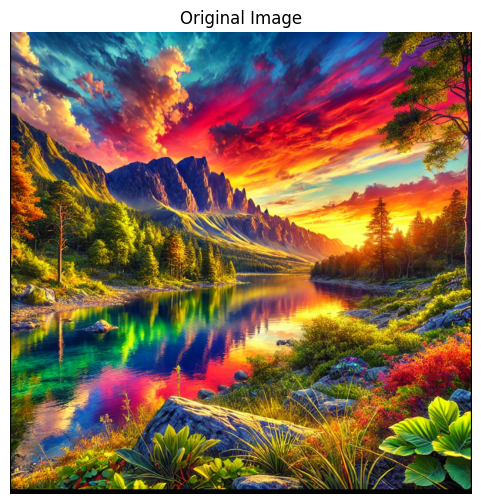

In [12]:
plt.figure(figsize=(6, 6))
plt.title("Original Image")
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.show()

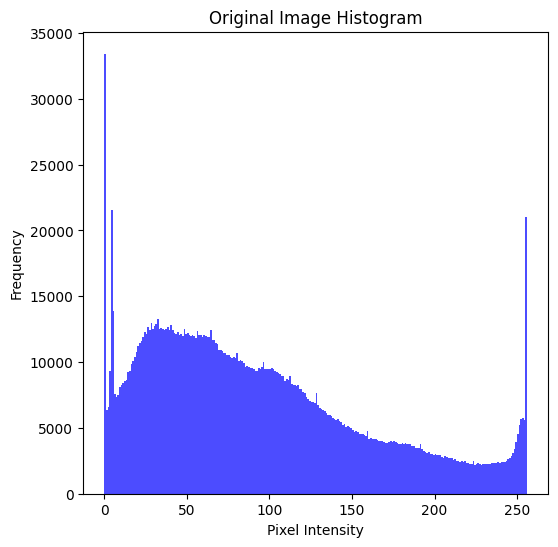

In [13]:
plt.figure(figsize=(6, 6))
plt.title("Original Image Histogram")
plt.hist(image.ravel(), bins=256, range=(0, 256), color="blue", alpha=0.7)
plt.xlabel("Pixel Intensity")
plt.ylabel("Frequency")
plt.show()

<h3 align="center" style="color:brown; font-size:200%; font-weight:bold;">Lossless  Compression Techniques</h3>

- Lossless image compression is a technique where the original image can be perfectly reconstructed from the compressed data without any loss of information.
- In other words, no data is lost during compression, and the image remains identical to the original when decompressed.
-  This technique is ideal for applications where maintaining the exact quality of the original image is critical, such as:
  
    - **Medical imaging:**  In medical imaging, lossless compression is used to store and transmit critical diagnostic images like X-rays, MRIs, and CT scans. The ability to reconstruct the image without any data loss ensures that no important details are altered or missed, which is essential for accurate diagnosis and treatment planning.
    - **Technical drawings:**  Technical drawings, such as CAD (Computer-Aided Design) files, blueprints, or engineering schematics, require precise detail preservation. Lossless compression allows these files to be reduced in size for efficient storage and sharing.
    - **Text-based images:**  Text-based images, such as scanned documents, charts, or diagrams, rely on lossless compression to preserve text clarity and legibility.For instance, when archiving a contract or a historical manuscript, every detail must be preserved exactly as in the original.

The following are some of the lossless image compression algorithms include:

- **Huffman coding**
- **Run-Length Encoding (RLE)**
- **Lempel-Ziv-Welch (LZW)**


<h3 align="center" style="color:brown; font-size:200%; font-weight:bold;">Huffman Coding</h3>

**Definition:**  
- Huffman Coding is a lossless data compression algorithm that assigns shorter binary codes to more frequently occurring data and longer codes to less frequent data.
- Huffman Coding works by analyzing the frequency of each symbol in the input data and constructing a binary tree, known as the Huffman Tree, to represent these frequencies.
- The symbols with higher frequencies are placed closer to the root of the tree, resulting in shorter binary codes, while less frequent symbols are assigned longer binary codes.
- This method ensures that no two codes overlap (prefix-free), making it highly efficient for data compression.
- Huffman coding is effective
- when the image has a skewed pixel distribution (many pixels of the same value, e.g., black-and-white images).

**For example:** 
- If you were compressing the string **"AABBBCCCC"**, Huffman Coding might assign:  
  - **A** → `10`  
  - **B** → `0`  
  - **C** → `11`  
This reduces the total number of bits required to store the data compared to fixed-length encoding.

**Applications:**  
In lossless image compression, Huffman Coding is often applied to the pixel intensity values or color channels of an image. For example:
- In a grayscale image, pixel intensities that occur more frequently (e.g., background pixels in a simple image) are assigned shorter codes.
- This helps in reducing the overall storage size without losing any information in the image.

Huffman Coding is particularly effective when the data has skewed frequency distributions, such as in run-length encoded data or images with limited color palettes.

### **Frequency of Pixel Intensities:**

In [14]:
unique, counts = np.unique(image, return_counts=True)

In [7]:
frequency = dict(zip(unique, counts))

In [8]:
print("Frequency Dictionary (Pixel Intensity: Frequency):")
for pixel_value, count in frequency.items():
    print(f"{pixel_value}: {count}")

Frequency Dictionary (Pixel Intensity: Frequency):
0: 33420
1: 6396
2: 6583
3: 9329
4: 21579
5: 13901
6: 7545
7: 7313
8: 7515
9: 8097
10: 8275
11: 8394
12: 8561
13: 8656
14: 9217
15: 9327
16: 9869
17: 10089
18: 10419
19: 10775
20: 11203
21: 11442
22: 11583
23: 11905
24: 12279
25: 12113
26: 12698
27: 12440
28: 12951
29: 12474
30: 12712
31: 12889
32: 13242
33: 12513
34: 12616
35: 12524
36: 12470
37: 12478
38: 12657
39: 12450
40: 12801
41: 12432
42: 12240
43: 12144
44: 12254
45: 12052
46: 12168
47: 12013
48: 12480
49: 12113
50: 12196
51: 12052
52: 11956
53: 12040
54: 11950
55: 11832
56: 12351
57: 12045
58: 12050
59: 11932
60: 12030
61: 12017
62: 11889
63: 11884
64: 12469
65: 11710
66: 11641
67: 11445
68: 11337
69: 10948
70: 10945
71: 10865
72: 10672
73: 10707
74: 10546
75: 10515
76: 10379
77: 10271
78: 10419
79: 10322
80: 10692
81: 10074
82: 10133
83: 10104
84: 9897
85: 9660
86: 9715
87: 9618
88: 9522
89: 9541
90: 9469
91: 9300
92: 9327
93: 9578
94: 9493
95: 9631
96: 9967
97: 9456
98: 943

In [9]:
heap = [[weight, [symbol, ""]] for symbol, weight in frequency.items()] # Creating a priority queue (min-heap) for the Huffman tree
heapify(heap)

while len(heap) > 1: # Building the Huffman Tree
    low = heappop(heap)
    high = heappop(heap)
    for pair in low[1:]:
        pair[1] = '0' + pair[1]
    for pair in high[1:]:
        pair[1] = '1' + pair[1]
    heappush(heap, [low[0] + high[0]] + low[1:] + high[1:])

### **Huffman Code Table:**

In [10]:
huffman_table = {symbol: code for symbol, code in sorted(heappop(heap)[1:], key=lambda p: (len(p[-1]), p))}

In [11]:
print("Huffman Table (Symbol: Huffman Code and Length):")
for symbol, code in huffman_table.items():
    code_length = len(code)
    print(f"{symbol}: {code} (Code Length: {code_length})")

Huffman Table (Symbol: Huffman Code and Length):
0: 101110 (Code Length: 6)
4: 000001 (Code Length: 6)
5: 1001001 (Code Length: 7)
19: 0000100 (Code Length: 7)
20: 0001010 (Code Length: 7)
21: 0001111 (Code Length: 7)
22: 0010010 (Code Length: 7)
23: 0011010 (Code Length: 7)
24: 0101111 (Code Length: 7)
25: 0100111 (Code Length: 7)
26: 0111110 (Code Length: 7)
27: 0110010 (Code Length: 7)
28: 1000100 (Code Length: 7)
29: 0110111 (Code Length: 7)
30: 1000000 (Code Length: 7)
31: 1000011 (Code Length: 7)
32: 1000110 (Code Length: 7)
33: 0111010 (Code Length: 7)
34: 0111100 (Code Length: 7)
35: 0111011 (Code Length: 7)
36: 0110110 (Code Length: 7)
37: 0111000 (Code Length: 7)
38: 0111101 (Code Length: 7)
39: 0110100 (Code Length: 7)
40: 1000001 (Code Length: 7)
41: 0110001 (Code Length: 7)
42: 0101101 (Code Length: 7)
43: 0101010 (Code Length: 7)
44: 0101110 (Code Length: 7)
45: 0100101 (Code Length: 7)
46: 0101011 (Code Length: 7)
47: 0011111 (Code Length: 7)
48: 0111001 (Code Length: 7)

### **Huffman Code Length Distribution:**

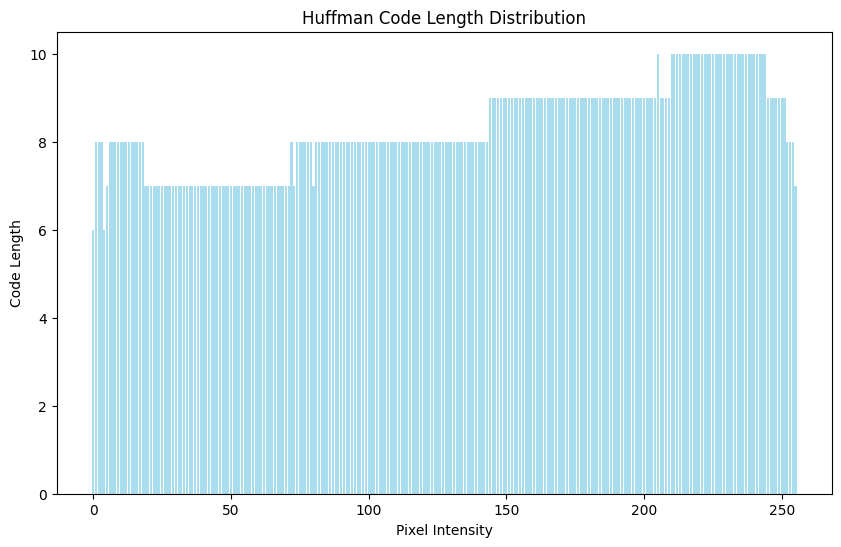

In [12]:
huffman_code_lengths = [len(code) for code in huffman_table.values()]
huffman_symbols = list(huffman_table.keys())

plt.figure(figsize=(10, 6))
plt.bar(huffman_symbols, huffman_code_lengths, color='skyblue', alpha=0.7)
plt.title("Huffman Code Length Distribution")
plt.xlabel("Pixel Intensity")
plt.ylabel("Code Length")
plt.show()

In [15]:
unique, counts = np.unique(image, return_counts=True)

In [16]:
frequency = dict(zip(unique, counts))
print("Frequency Dictionary (Pixel Intensity: Frequency):")
for pixel_value, count in frequency.items():
    print(f"{pixel_value}: {count}")

Frequency Dictionary (Pixel Intensity: Frequency):
0: 33420
1: 6396
2: 6583
3: 9329
4: 21579
5: 13901
6: 7545
7: 7313
8: 7515
9: 8097
10: 8275
11: 8394
12: 8561
13: 8656
14: 9217
15: 9327
16: 9869
17: 10089
18: 10419
19: 10775
20: 11203
21: 11442
22: 11583
23: 11905
24: 12279
25: 12113
26: 12698
27: 12440
28: 12951
29: 12474
30: 12712
31: 12889
32: 13242
33: 12513
34: 12616
35: 12524
36: 12470
37: 12478
38: 12657
39: 12450
40: 12801
41: 12432
42: 12240
43: 12144
44: 12254
45: 12052
46: 12168
47: 12013
48: 12480
49: 12113
50: 12196
51: 12052
52: 11956
53: 12040
54: 11950
55: 11832
56: 12351
57: 12045
58: 12050
59: 11932
60: 12030
61: 12017
62: 11889
63: 11884
64: 12469
65: 11710
66: 11641
67: 11445
68: 11337
69: 10948
70: 10945
71: 10865
72: 10672
73: 10707
74: 10546
75: 10515
76: 10379
77: 10271
78: 10419
79: 10322
80: 10692
81: 10074
82: 10133
83: 10104
84: 9897
85: 9660
86: 9715
87: 9618
88: 9522
89: 9541
90: 9469
91: 9300
92: 9327
93: 9578
94: 9493
95: 9631
96: 9967
97: 9456
98: 943

In [17]:
heap = [[weight, [symbol, ""]] for symbol, weight in frequency.items()] # Creating a priority queue (min-heap) for the Huffman tree
heapify(heap)

while len(heap) > 1: # Building the Huffman Tree
    low = heappop(heap)
    high = heappop(heap)
    for pair in low[1:]:
        pair[1] = '0' + pair[1]
    for pair in high[1:]:
        pair[1] = '1' + pair[1]
    heappush(heap, [low[0] + high[0]] + low[1:] + high[1:])

In [18]:
huffman_table = {symbol: code for symbol, code in sorted(heappop(heap)[1:], key=lambda p: (len(p[-1]), p))} ##Huffman code table
print("Huffman Table (Symbol: Huffman Code and Length):")
for symbol, code in huffman_table.items():
    code_length = len(code)
    print(f"{symbol}: {code} (Code Length: {code_length})")

Huffman Table (Symbol: Huffman Code and Length):
0: 101110 (Code Length: 6)
4: 000001 (Code Length: 6)
5: 1001001 (Code Length: 7)
19: 0000100 (Code Length: 7)
20: 0001010 (Code Length: 7)
21: 0001111 (Code Length: 7)
22: 0010010 (Code Length: 7)
23: 0011010 (Code Length: 7)
24: 0101111 (Code Length: 7)
25: 0100111 (Code Length: 7)
26: 0111110 (Code Length: 7)
27: 0110010 (Code Length: 7)
28: 1000100 (Code Length: 7)
29: 0110111 (Code Length: 7)
30: 1000000 (Code Length: 7)
31: 1000011 (Code Length: 7)
32: 1000110 (Code Length: 7)
33: 0111010 (Code Length: 7)
34: 0111100 (Code Length: 7)
35: 0111011 (Code Length: 7)
36: 0110110 (Code Length: 7)
37: 0111000 (Code Length: 7)
38: 0111101 (Code Length: 7)
39: 0110100 (Code Length: 7)
40: 1000001 (Code Length: 7)
41: 0110001 (Code Length: 7)
42: 0101101 (Code Length: 7)
43: 0101010 (Code Length: 7)
44: 0101110 (Code Length: 7)
45: 0100101 (Code Length: 7)
46: 0101011 (Code Length: 7)
47: 0011111 (Code Length: 7)
48: 0111001 (Code Length: 7)

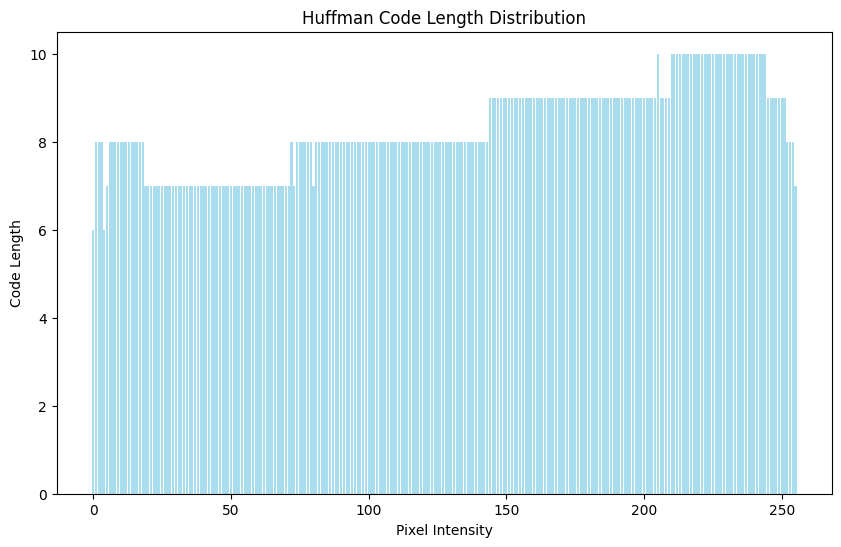

In [19]:
huffman_code_lengths = [len(code) for code in huffman_table.values()]
huffman_symbols = list(huffman_table.keys())

plt.figure(figsize=(10, 6))
plt.bar(huffman_symbols, huffman_code_lengths, color='skyblue', alpha=0.7)
plt.title("Huffman Code Length Distribution")
plt.xlabel("Pixel Intensity")
plt.ylabel("Code Length")
plt.show()


## **Encoding image:**

In [20]:
huffman_encoded_image = ''.join(huffman_table[pixel] for pixel in image.ravel())

In [21]:
total_length_bits = len(huffman_encoded_image)
print(f"Total Length of Encoded Huffman Binary String: {total_length_bits} bits")

Total Length of Encoded Huffman Binary String: 14488509 bits


In [22]:
print("Encoded Image (Huffman Compressed Binary String):")
print(huffman_encoded_image[:100]) 

Encoded Image (Huffman Compressed Binary String):
1011001010101110101011101011001010101110101011101000111100111101101101111010100110001110010101001100


### **Reverse Huffman table:**

In [23]:
reverse_huffman_table = {code: symbol for symbol, code in huffman_table.items()}
print("Reverse Huffman Table (Huffman Code: Symbol):")
for code, symbol in reverse_huffman_table.items():
    print(f"{code}: {symbol}")

Reverse Huffman Table (Huffman Code: Symbol):
101110: 0
000001: 4
1001001: 5
0000100: 19
0001010: 20
0001111: 21
0010010: 22
0011010: 23
0101111: 24
0100111: 25
0111110: 26
0110010: 27
1000100: 28
0110111: 29
1000000: 30
1000011: 31
1000110: 32
0111010: 33
0111100: 34
0111011: 35
0110110: 36
0111000: 37
0111101: 38
0110100: 39
1000001: 40
0110001: 41
0101101: 42
0101010: 43
0101110: 44
0100101: 45
0101011: 46
0011111: 47
0111001: 48
0101000: 49
0101100: 50
0100110: 51
0011101: 52
0100010: 53
0011100: 54
0010110: 55
0110000: 56
0100011: 57
0100100: 58
0011011: 59
0100001: 60
0100000: 61
0011001: 62
0011000: 63
0110101: 64
0010101: 65
0010011: 66
0010000: 67
0001101: 68
0001000: 69
0000110: 70
0000101: 71
0000001: 73
0000000: 80
1111101: 255
10000100: 1
10001011: 2
11010100: 3
10100000: 6
10011010: 7
10011101: 8
10101110: 9
10110010: 10
10111100: 11
10111101: 12
11000000: 13
11001101: 14
11010010: 15
11101001: 16
11101111: 17
11110111: 18
11111110: 72
11111101: 74
11111100: 75
11110110: 

### **Decoding the Huffman-encoded image:**


In [24]:
decoded_image_hf = []
current_code = ""
for bit in huffman_encoded_image:
    current_code += bit
    if current_code in reverse_huffman_table:
        decoded_image_hf.append(reverse_huffman_table[current_code])
        current_code = ""
decoded_image_hf = np.array(decoded_image_hf).reshape(image.shape)

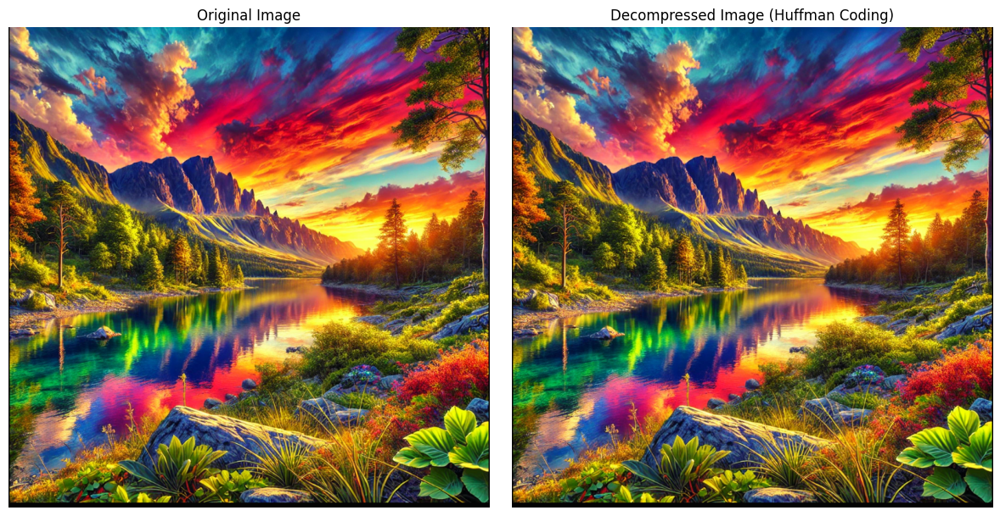

In [25]:
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis("off")

plt.subplot(1, 2, 2)
plt.title("Decompressed Image (Huffman Coding)")
plt.imshow(cv2.cvtColor(decoded_image_hf, cv2.COLOR_BGR2RGB))
plt.axis("off")

plt.tight_layout()
plt.show()

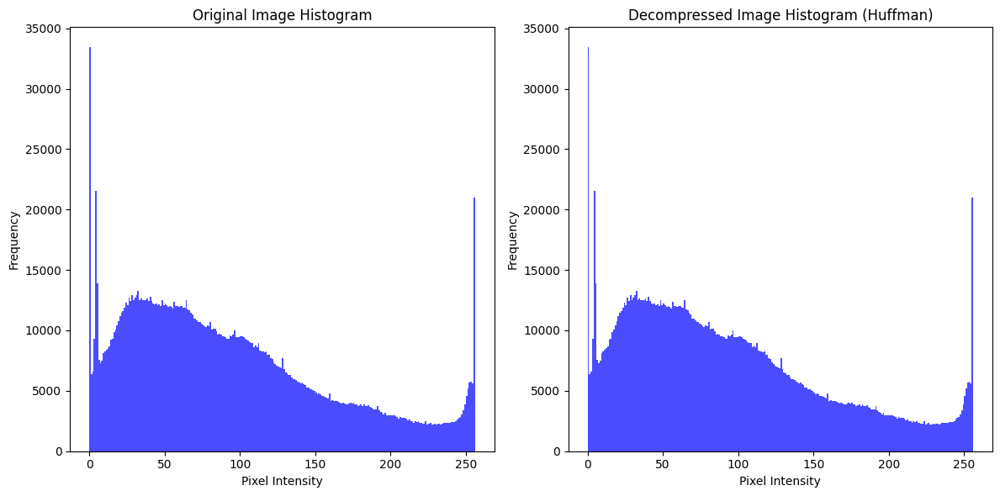

In [26]:
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.title("Original Image Histogram")
plt.hist(image.ravel(), bins=256, range=(0, 256), color="blue", alpha=0.7)
plt.xlabel("Pixel Intensity")
plt.ylabel("Frequency")

plt.subplot(1, 2, 2)
plt.title("Decompressed Image Histogram (Huffman)")
plt.hist(decoded_image_hf.ravel(), bins=256, range=(0, 256), color="blue", alpha=0.7)
plt.xlabel("Pixel Intensity")
plt.ylabel("Frequency")

plt.tight_layout()
plt.show()

In [27]:
if np.array_equal(image, decoded_image_hf):
    print("The decoded image is identical to the original image.")
else:
    print("The decoded image differs from the original image.")

The decoded image is identical to the original image.


### **Original and Huffman compressed sizes Comparison:**

In [28]:
original_size_bits_hf = image.size * 8  
compressed_size_bits_hf = len(huffman_encoded_image)

original_size_bytes_hf = int(original_size_bits_hf / 8)
compressed_size_bytes_hf = int(compressed_size_bits_hf / 8)
original_size_kb_hf = original_size_bytes_hf / 1024
compressed_size_kb_hf = compressed_size_bytes_hf / 1024

In [29]:
print(f"Original Size (Huffman): {original_size_bits_hf} bits ({original_size_bytes_hf} bytes, {original_size_kb_hf:.2f} KB)")
print(f"Compressed Size (Huffman): {compressed_size_bits_hf} bits ({compressed_size_bytes_hf} bytes, {compressed_size_kb_hf:.2f} KB)")

Original Size (Huffman): 14845968 bits (1855746 bytes, 1812.25 KB)
Compressed Size (Huffman): 14488509 bits (1811063 bytes, 1768.62 KB)


### **Inference:**
- The **original size** of the image is **14845968 bits** (1812.25 KB), representing the amount of data required to store the image before compression.
- After applying **Huffman coding**, the **compressed size** is reduced to **14488509 bits** (1768.62 KB), showing a decrease in size. This indicates that Huffman coding has reduced the image size by approximately **3.5%**.

### **Performance Metrics:**

In [30]:
compression_ratio_hf = compressed_size_bits_hf / original_size_bits_hf
compression_factor_hf = original_size_bits_hf / compressed_size_bits_hf

mse_hf = np.mean((image - decoded_image_hf) ** 2) # Mean Squared Error (MSE)
if mse_hf == 0:
    psnr_hf = float('inf')  
else:
    psnr_hf = 10 * np.log10((255 ** 2) / mse_hf) # Peak Signal-to-Noise Ratio (PSNR)

In [31]:
print(f"Compression Ratio: {compression_ratio_hf:.4f} (Compressed/Original)")
print(f"Compression Factor: {compression_factor_hf:.4f} (Original/Compressed)")
print(f"Mean Squared Error (MSE): {mse_hf:.4f}")
print(f"Peak Signal-to-Noise Ratio (PSNR): {psnr_hf:.2f} dB")

Compression Ratio: 0.9759 (Compressed/Original)
Compression Factor: 1.0247 (Original/Compressed)
Mean Squared Error (MSE): 0.0000
Peak Signal-to-Noise Ratio (PSNR): inf dB


### **Interpretation**

- **Compression Ratio (0.9759)**: The compressed image size is approximately 97.59% of the original. This modest reduction is characteristic of Huffman coding, as it focuses on optimizing data representation without discarding any information.

- **Compression Factor (1.0247)**: The original image size is roughly 1.0247 times larger than the compressed size, indicating only a slight improvement in storage efficiency. This limited reduction occurs because Huffman coding depends on the redundancy of the image data, and some images may not compress significantly.

- **Mean Squared Error (MSE: 0.0000)**: The zero MSE confirms perfect reconstruction of the image after decompression, as no data is lost during the compression process.

- **Peak Signal-to-Noise Ratio (PSNR: inf dB)**: The infinite PSNR value signifies that the compressed image retains 100% of the quality of the original image, a hallmark of lossless comp content.
ervation.


## **Interpretation:**
- The **compression ratio** is **0.1225**, meaning the compressed image is only **12.25%** of the original size, indicating significant compression efficiency.

- The **compression factor** is **8.1653**, which means the image is approximately **8.17 times smaller** in its compressed form than in its original form.

- The **Mean Squared Error (MSE)** is **0.0000**, indicating that the decompressed image is **identical** to the original, with no loss of information.

- The **Peak Signal-to-Noise Ratio (PSNR)** is **infinite (inf)**, which further confirms that the decompressed image is **perfectly identical** to the original image, indicating lossless compression.

### **Insights:**
- Huffman coding has achieved a modest yet effective reduction in image size with a compression ratio of 0.9759 and a compression factor of 1.0247, demonstrating its ability to optimize storage space in a lossless manner.
- The Mean Squared Error (MSE) of 0.0000 and the infinite Peak Signal-to-Noise Ratio (PSNR) confirm that the decompressed image is identical to the original, with no loss of data or quality.
- Huffman coding offers an effective solution for lossless image compression, ensuring reliable compression without any compromise in image fidelity.


<h3 align="center" style="color:brown; font-size:200%; font-weight:bold;">Run Length Encoding (RLE)</h3>

 Run-Length Encoding (RLE) is a simple data compression algorithm that reduces the size of data by encoding sequences of the same data value (repeated values) as a single data value and the count of how many times it repeats. This technique is particularly effective for data containing long runs of a single value, such as simple graphics or black-and-white images.

**Working:**

- RLE works by scanning the input data and identifying consecutive sequences of the same value.
- Instead of storing the repeated values individually, it stores the value along with the number of times it repeats.


### Example of RLE Coding with Pixel Values

Consider the following sequence of pixel values (8-bit grayscale values):

`255, 255, 255, 0, 0, 128, 128, 128, 255, 255`

**Step-by-Step Encoding:**

1. **Identify runs of repeated pixel values:**
   - Pixel value `255` appears 3 times
   - Pixel value `0` appears 2 times
   - Pixel value `128` appears 3 times
   - Pixel value `255` appears 2 times

2. **Encode each run as the pixel value and count:**
   - `255` appears 3 times → (255, 3)
   - `0` appears 2 times → (0, 2)
   - `128` appears 3 times → (128, 3)
   - `255` appears 2 times → (255, 2)

**RLE Encoded Output:**

`(255, 3), (0, 2), (128, 3), (255, 2)`

**Explanation:**

- The original pixel sequence `[255, 255, 255, 0, 0, 128, 128, 128, 255, 255]` is compressed by storing each sequence of repeated pixel values as a tuple of the pixel value and the count of its occurrences.
- The original sequence with 10 pixel values is compressed to just 4 tuples, demonstrating the efficiency of RLE when there are long runs of repeated values in the pixel data.


In [32]:
def run_length_encoding(image_pixels):
    encoded_data = []  # Holds the RLE result
    current_pixel = image_pixels[0]  # Start with the first pixel
    count = 1  # Initialize the run-length counter

    # Traverse through the image pixel data
    for i in range(1, len(image_pixels)):
        if image_pixels[i] == current_pixel:
            count += 1
        else:
            encoded_data.append((current_pixel, count))
            current_pixel = image_pixels[i]  # Update the current pixel
            count = 1  # Reset the counter
    encoded_data.append((current_pixel, count))
    return encoded_data

In [33]:
image_pixels = image.ravel()
encoded_image_rle = run_length_encoding(image_pixels)

print("RLE Encoded Image (Pixel Value, Run Length):")
for pixel_value, run_length in encoded_image_rle:
    print(f"Pixel: {pixel_value}, Run Length: {run_length}")

RLE Encoded Image (Pixel Value, Run Length):
Pixel: 10, Run Length: 1
Pixel: 9, Run Length: 2
Pixel: 10, Run Length: 1
Pixel: 9, Run Length: 2
Pixel: 129, Run Length: 1
Pixel: 136, Run Length: 1
Pixel: 161, Run Length: 1
Pixel: 134, Run Length: 1
Pixel: 141, Run Length: 1
Pixel: 167, Run Length: 1
Pixel: 136, Run Length: 1
Pixel: 143, Run Length: 1
Pixel: 170, Run Length: 1
Pixel: 136, Run Length: 1
Pixel: 142, Run Length: 1
Pixel: 172, Run Length: 1
Pixel: 135, Run Length: 1
Pixel: 141, Run Length: 1
Pixel: 173, Run Length: 1
Pixel: 132, Run Length: 1
Pixel: 138, Run Length: 1
Pixel: 170, Run Length: 1
Pixel: 129, Run Length: 1
Pixel: 138, Run Length: 1
Pixel: 167, Run Length: 1
Pixel: 127, Run Length: 1
Pixel: 136, Run Length: 1
Pixel: 163, Run Length: 1
Pixel: 132, Run Length: 1
Pixel: 140, Run Length: 1
Pixel: 164, Run Length: 1
Pixel: 115, Run Length: 1
Pixel: 120, Run Length: 1
Pixel: 152, Run Length: 1
Pixel: 128, Run Length: 1
Pixel: 131, Run Length: 1
Pixel: 173, Run Length: 1

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Pixel: 43, Run Length: 1
Pixel: 46, Run Length: 1
Pixel: 70, Run Length: 1
Pixel: 37, Run Length: 2
Pixel: 70, Run Length: 1
Pixel: 34, Run Length: 1
Pixel: 31, Run Length: 1
Pixel: 58, Run Length: 1
Pixel: 24, Run Length: 1
Pixel: 21, Run Length: 1
Pixel: 46, Run Length: 1
Pixel: 24, Run Length: 1
Pixel: 21, Run Length: 1
Pixel: 50, Run Length: 1
Pixel: 23, Run Length: 1
Pixel: 22, Run Length: 1
Pixel: 61, Run Length: 1
Pixel: 26, Run Length: 1
Pixel: 27, Run Length: 1
Pixel: 68, Run Length: 1
Pixel: 28, Run Length: 1
Pixel: 30, Run Length: 1
Pixel: 65, Run Length: 1
Pixel: 29, Run Length: 1
Pixel: 27, Run Length: 1
Pixel: 61, Run Length: 1
Pixel: 30, Run Length: 1
Pixel: 25, Run Length: 1
Pixel: 54, Run Length: 1
Pixel: 30, Run Length: 1
Pixel: 28, Run Length: 1
Pixel: 50, Run Length: 1
Pixel: 45, Run Length: 1
Pixel: 49, Run Length: 1
Pixel: 45, Run Length: 1
Pixel: 64, Run Length: 1
Pixel: 78, Run Length: 1
Pixel: 46, Run Length: 1
Pixel: 93, Run Length: 1
Pixel: 124, Run Length: 1

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




Pixel: 52, Run Length: 1
Pixel: 124, Run Length: 1
Pixel: 14, Run Length: 1
Pixel: 45, Run Length: 1
Pixel: 119, Run Length: 1
Pixel: 12, Run Length: 1
Pixel: 40, Run Length: 1
Pixel: 113, Run Length: 1
Pixel: 11, Run Length: 1
Pixel: 45, Run Length: 1
Pixel: 111, Run Length: 1
Pixel: 10, Run Length: 1
Pixel: 39, Run Length: 1
Pixel: 100, Run Length: 1
Pixel: 15, Run Length: 1
Pixel: 40, Run Length: 1
Pixel: 96, Run Length: 1
Pixel: 21, Run Length: 1
Pixel: 51, Run Length: 1
Pixel: 107, Run Length: 1
Pixel: 18, Run Length: 1
Pixel: 55, Run Length: 1
Pixel: 110, Run Length: 1
Pixel: 17, Run Length: 1
Pixel: 62, Run Length: 1
Pixel: 115, Run Length: 1
Pixel: 23, Run Length: 1
Pixel: 73, Run Length: 1
Pixel: 126, Run Length: 1
Pixel: 17, Run Length: 1
Pixel: 65, Run Length: 1
Pixel: 113, Run Length: 1
Pixel: 15, Run Length: 1
Pixel: 58, Run Length: 1
Pixel: 103, Run Length: 1
Pixel: 17, Run Length: 1
Pixel: 64, Run Length: 1
Pixel: 114, Run Length: 1
Pixel: 29, Run Length: 1
Pixel: 74, R

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Pixel: 127, Run Length: 1
Pixel: 27, Run Length: 1
Pixel: 9, Run Length: 1
Pixel: 153, Run Length: 1
Pixel: 63, Run Length: 1
Pixel: 42, Run Length: 1
Pixel: 196, Run Length: 1
Pixel: 45, Run Length: 1
Pixel: 24, Run Length: 1
Pixel: 174, Run Length: 1
Pixel: 19, Run Length: 1
Pixel: 0, Run Length: 1
Pixel: 132, Run Length: 1
Pixel: 22, Run Length: 1
Pixel: 7, Run Length: 1
Pixel: 113, Run Length: 1
Pixel: 18, Run Length: 1
Pixel: 11, Run Length: 1
Pixel: 86, Run Length: 1
Pixel: 28, Run Length: 1
Pixel: 12, Run Length: 1
Pixel: 90, Run Length: 1
Pixel: 31, Run Length: 1
Pixel: 13, Run Length: 1
Pixel: 102, Run Length: 1
Pixel: 32, Run Length: 1
Pixel: 23, Run Length: 1
Pixel: 129, Run Length: 1
Pixel: 24, Run Length: 1
Pixel: 9, Run Length: 1
Pixel: 135, Run Length: 1
Pixel: 12, Run Length: 1
Pixel: 5, Run Length: 1
Pixel: 144, Run Length: 1
Pixel: 21, Run Length: 1
Pixel: 42, Run Length: 1
Pixel: 184, Run Length: 1
Pixel: 39, Run Length: 1
Pixel: 99, Run Length: 1
Pixel: 218, Run Len

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [34]:
encoded_sequence_rle = ''.join([f'{pixel_value}{run_length}' for pixel_value, run_length in encoded_image_rle])

In [35]:
length_bits_rle = len(encoded_sequence_rle)
print(f"Total Length of Encoded Huffman Binary String: {total_length_bits} bits")

Total Length of Encoded Huffman Binary String: 14488509 bits


In [36]:
print(f"\nCompressed Image Sequence (RLE): {encoded_sequence_rle[:100]}...")  # Truncated for readability


Compressed Image Sequence (RLE): 1019210192129113611611134114111671136114311701136114211721135114111731132113811701129113811671127113...


In [37]:
decoded_image_rle = []
for pixel_value, run_length in encoded_image_rle:
    decoded_image_rle.extend([pixel_value] * run_length)

decoded_image_rle = np.array(decoded_image_rle).reshape(image.shape)

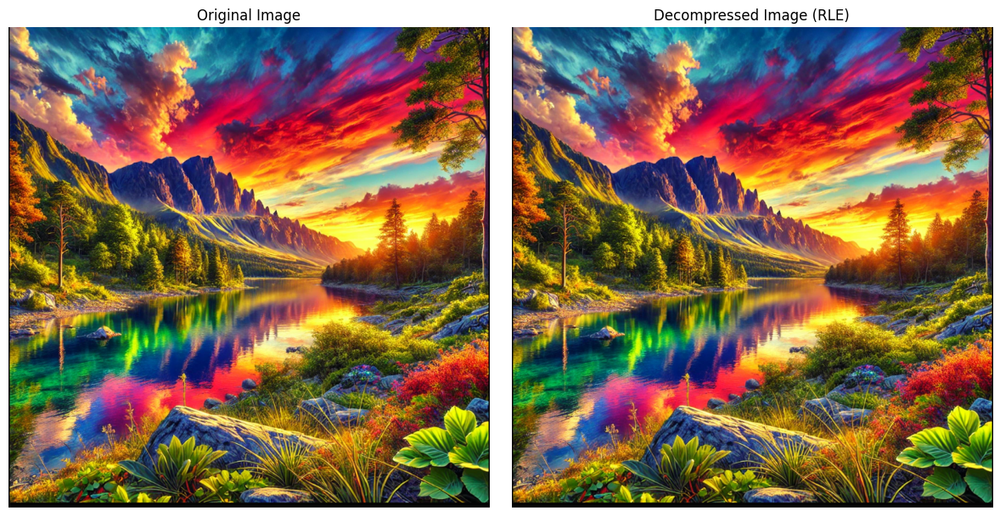

In [38]:
# Display the original and RLE decompressed images side by side
plt.figure(figsize=(12, 6))
# Original Image
plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis("off")

# Decompressed Image (RLE)
plt.subplot(1, 2, 2)
plt.title("Decompressed Image (RLE)")
plt.imshow(cv2.cvtColor(decoded_image_rle, cv2.COLOR_BGR2RGB))
plt.axis("off")

plt.tight_layout()
plt.show()


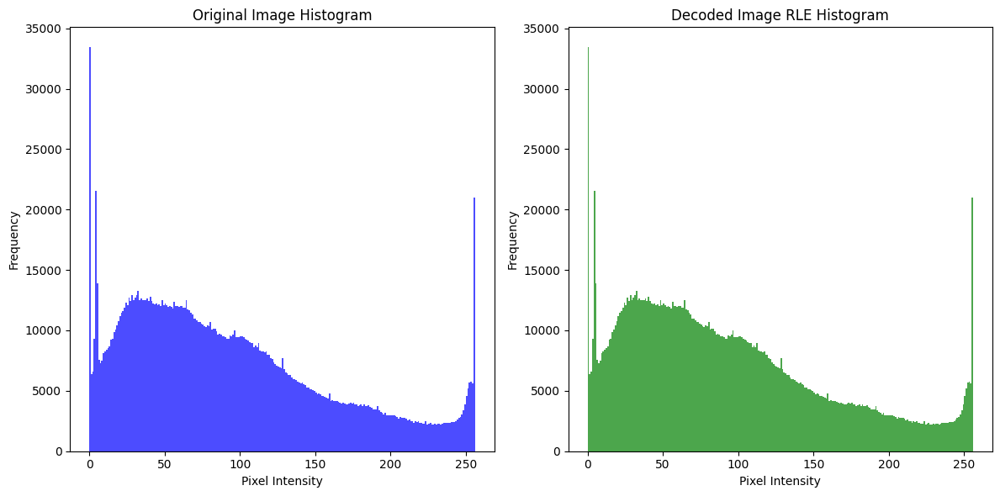

In [39]:
plt.figure(figsize=(12, 6))

# Original image histogram
plt.subplot(1, 2, 1)
plt.title("Original Image Histogram")
plt.hist(image.ravel(), bins=256, range=(0, 256), color="blue", alpha=0.7)
plt.xlabel("Pixel Intensity")
plt.ylabel("Frequency")

# Decoded image histogram
plt.subplot(1, 2, 2)
plt.title("Decoded Image RLE Histogram")
plt.hist(decoded_image_rle.ravel(), bins=256, range=(0, 256), color="green", alpha=0.7)
plt.xlabel("Pixel Intensity")
plt.ylabel("Frequency")

plt.tight_layout()
plt.show()

In [40]:
if np.array_equal(image, decoded_image_rle):
    print("The decoded image is identical to the original image.")
else:
    print("The decoded image differs from the original image.")

The decoded image is identical to the original image.


### **Original and RLE compressed sizes Comparison:**

In [41]:
original_size_bits_rle = image.size * 8  
compressed_size_bits_rle = len(encoded_sequence_rle)  

original_size_bytes_rle = original_size_bits_rle/8 ## Converting into bytes
compressed_size_bytes_rle = compressed_size_bits_rle/8

original_size_kb_rle = original_size_bytes_rle / 1024 ## Converting into KB
compressed_size_kb_rle = compressed_size_bytes_rle / 1024

In [42]:
print(f"Original Size (RLE): {original_size_bits_rle} bits ({original_size_bytes_rle} bytes, {original_size_kb_rle:.2f} KB)")
print(f"Compressed Size (RLE): {compressed_size_bits_rle} bits ({compressed_size_bytes_rle} bytes, {compressed_size_kb_rle:.2f} KB)")

Original Size (RLE): 14845968 bits (1855746.0 bytes, 1812.25 KB)
Compressed Size (RLE): 6087365 bits (760920.625 bytes, 743.09 KB)


### **Inference:**
- The original image size is 14845968 bits (1855746.0 bytes or 1812.25 KB).
- After compression with RLE, the size is reduced to 6087365 bits (760920.625 bytes or 743.09 KB).
- The compression resulted in a **percentage reduction of approximately 59.03%**, indicating a significant reduction in size while preserving essential data.
- This reduction demonstrates the effectiveness of Run-Length Encoding in optimizing storage requirements and transmission efficiency.
.


## **Performance metrics:** 

In [43]:
compression_ratio_rle = compressed_size_bits_rle / original_size_bits_rle
compression_factor_rle = original_size_bits_rle/compressed_size_bits_rle
mse_rle = np.mean((image - decoded_image_rle) ** 2)
if mse_rle == 0:
    psnr_rle = float('inf')
else:
    psnr_rle = 10 * np.log10((255**2) / mse_rle)

In [44]:
print(f"RLE Compression Ratio: {compression_ratio_rle:.4f}")
print(f"RLE Compression Factor: {compression_factor_rle:.4f}")
print(f"Mean Squared Error (MSE) for RLE: {mse_rle:.4f}")
print(f"Peak Signal-to-Noise Ratio (PSNR) for RLE: {psnr_rle:.4f}")

RLE Compression Ratio: 0.4100
RLE Compression Factor: 2.4388
Mean Squared Error (MSE) for RLE: 0.0000
Peak Signal-to-Noise Ratio (PSNR) for RLE: inf


### **Interpretation:**
- **Compression Ratio (RLE)**: The compression ratio is 0.4100, meaning the compressed image is approximately 41% of the original size. This indicates that RLE has successfully reduced the image size to less than half of its original size, demonstrating effective compression.

- **Compression Factor (RLE)**: The compression factor is 2.4388, meaning the image is approximately 2.44 times smaller after compression. This factor emphasizes the significant reduction in file size achieved by RLE.

- **Mean Squared Error (MSE) for RLE**: The MSE is 0.0000, indicating that the compressed image is identical to the original image when decompressed. There is no loss of information, confirming that RLE is a **lossless compression** technique.

- **Peak Signal-to-Noise Ratio (PSNR) for RLE**: The PSNR is infinite (inf), which further validates that there is no distortion or loss of quality in the decompressed image. A high PSNR value is typically associated with excellent image quality, confirming the effectiveness of RLE in maintaining the integrity of the image during compresquality.


### **Insights:**
- RLE has demonstrated excellent performance in compressing the image while maintaining its quality perfectly.
- The significant reduction in size, coupled with no loss of information (MSE = 0) and infinite PSNR, confirms that RLE is an effective lossless compression method.
- This technique is highly efficient in reducing storage requirements and transmission time without compromising image quality.

<h3 align="center" style="color:brown; font-size:200%; font-weight:bold;">LZW Coding</h3>

Lempel-Ziv (LZ) coding is a lossless data compression algorithm that replaces repeated occurrences of data with references to a single copy of that data. It builds a dictionary of sequences encountered in the data, which allows for the efficient encoding of repeating patterns.

LZ is the foundation for several compression schemes, including LZ77, LZ78, and LZW, which are widely used in formats like GIF, PNG, and others.

**Working:**

- LZ coding works by maintaining a dictionary of previously encountered sequences of data (in the case of image compression, sequences of pixel values). Whenever a new sequence of data is encountered, it is added to the dictionary.
- Instead of encoding the sequence of data repeatedly, the algorithm uses references (or pointers) to the previously encountered sequences in the dictionary. These references point to the location of the repeated sequence and the length of the sequence.
- The output consists of pairs of (reference, length) or sometimes just a reference index. This allows repeated sequences to be stored more efficiently.

### **Example:**

Consider the following sequence of pixel values:

`128, 128, 255, 128, 128, 128, 255, 255, 128`
1. **Dictionary Initialization**:
   - Start with an empty dictionary.
   - Input: `128, 128, 255, 128, 128, 128, 255, 255, 128`

2. **Encoding:**
   - `128` is added to the dictionary, output: `128`.
   - `255` is added, output: `255`.
   - The next `128` is already in the dictionary, output: `128` (reference).
   - `128, 128, 128` repeats, output: `(2, 3)` (reference to index `2`, length 3).
   - `255, 255` repeats, output: `(3, 2)` (reference to index `3`, length 2).

3. **Final Encoded Output**:
   - `128, 255, (2, 3), (3, 2), 128`

In [45]:
from collections import Counter

In [46]:
lz_height, lz_width, lz_channels = image.shape
lz_image_flat = image.flatten()  # Flatten the image for sequential processing

# Step 2: Initialize dictionary for LZW
lz_initial_dictionary = {tuple([i]): i for i in range(256)}  # For all possible grayscale values (0-255)
lz_next_code = 256  # Starting index for new patterns
lz_encoded_data = []  # Holds encoded indices
lz_pattern = tuple([lz_image_flat[0]])  # Initialize with the first pixel value

In [47]:
unique_pixels = np.unique(image)
print("Number of Unique Pixel Values:", len(unique_pixels))

Number of Unique Pixel Values: 256


In [48]:
pixel_patterns = Counter(image.flatten())
print("Most Common Pixel Patterns:", pixel_patterns.most_common(5))

Most Common Pixel Patterns: [(0, 33420), (4, 21579), (255, 21001), (5, 13901), (32, 13242)]


In [49]:
print(f"Dictionary Size: {lz_next_code} entries")

Dictionary Size: 256 entries


### **Encoding (LZW):**

In [50]:
for lz_pixel in lz_image_flat[1:]:
    lz_new_pattern = lz_pattern + tuple([lz_pixel])  # Extend the current pattern
    if lz_new_pattern in lz_initial_dictionary:
        lz_pattern = lz_new_pattern  # Continue building the pattern
    else:
        lz_encoded_data.append(lz_initial_dictionary[lz_pattern])
        lz_initial_dictionary[lz_new_pattern] = lz_next_code
        lz_next_code += 1
        lz_pattern = tuple([lz_pixel])  # Reset the pattern

In [51]:
lz_encoded_data.append(lz_initial_dictionary[lz_pattern])

### **Decoding (LZW):**

In [52]:
lz_reverse_dictionary = {v: k for k, v in lz_initial_dictionary.items()}
lz_decoded_data = []
lz_current_code = lz_encoded_data[0]
lz_decoded_data.extend(lz_reverse_dictionary[lz_current_code])

for lz_code in lz_encoded_data[1:]:
    if lz_code in lz_reverse_dictionary:
        lz_entry = lz_reverse_dictionary[lz_code]
    else:
        lz_entry = lz_reverse_dictionary[lz_current_code] + lz_reverse_dictionary[lz_current_code][:1]
    lz_decoded_data.extend(lz_entry)
    lz_reverse_dictionary[lz_next_code] = lz_reverse_dictionary[lz_current_code] + lz_entry[:1]
    lz_next_code += 1
    lz_current_code = lz_code

In [53]:
lz_decoded_image = np.array(lz_decoded_data, dtype=np.uint8).reshape(lz_height, lz_width, lz_channels)

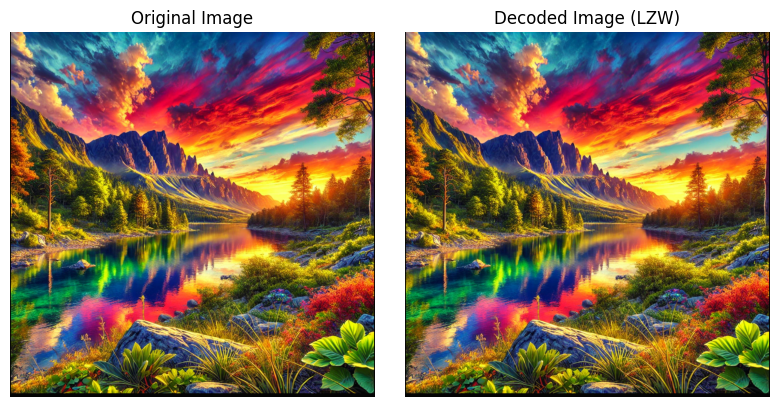

In [54]:
plt.figure(figsize=(12, 4))
# Original Image
plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis("off")
# Decoded Image (LZW)
plt.subplot(1, 3, 2)
plt.title("Decoded Image (LZW)")
plt.imshow(cv2.cvtColor(lz_decoded_image, cv2.COLOR_BGR2RGB))
plt.axis("off")
plt.tight_layout()
plt.show()


In [55]:
if np.array_equal(image, lz_decoded_image):
    print("The decoded image is identical to the original image.")
else:
    print("The decoded image differs from the original image.")

The decoded image is identical to the original image.


### **Original and LZW compressed sizes Comparison:**

In [56]:
lz_original_size_bits = lz_height * lz_width * lz_channels * 8  # Each pixel is 8 bits
lz_compressed_size_bits = len(lz_encoded_data) * int(np.ceil(np.log2(lz_next_code)))  # Bits per encoded index

lz_original_size_bytes = lz_original_size_bits // 8
lz_compressed_size_bytes = lz_compressed_size_bits // 8

lz_original_size_kb = lz_original_size_bytes / 1024
lz_compressed_size_kb = lz_compressed_size_bytes / 1024

In [57]:
print(f"Original Size (LZW): {lz_original_size_bits} bits ({lz_original_size_bytes} bytes, {lz_original_size_kb:.2f} KB)")
print(f"Compressed Size (LZW): {lz_compressed_size_bits} bits ({lz_compressed_size_bytes} bytes, {lz_compressed_size_kb:.2f} KB)")

Original Size (LZW): 14845968 bits (1855746 bytes, 1812.25 KB)
Compressed Size (LZW): 19052166 bits (2381520 bytes, 2325.70 KB)


### **Inference:**
- The original image size was **14845968 bits (1812.25 KB)**, while the compressed size after applying LZW was **19052166 bits (2325.70 KB)**, indicating an increase in size instead of a reduction.

- Despite being a lossless compression algorithm, LZW failed to compress the image effectively in this case instead, it added overhead, resulting in a larger file size.

- LZW works by identifying repeated patterns and replacing them with shorter codes from a dynamically built dictionary. However, if the image lacks sufficient redundancy or repetitive patterns, the algorithm's dictionary may add more data than it removes.

- The increase in size suggests that the image's content is either too complex or not well-suited for LZW compression, highlighting its limitations in certain scenarios.

- This result emphasizes the importance of choosing the right compression algorithm based on the nature of the data.


### **Performance Metrics:**

In [58]:
lz_compression_ratio = lz_compressed_size_bits / lz_original_size_bits
lz_compression_factor = lz_original_size_bits / lz_compressed_size_bits

lz_mse = np.mean((image - lz_decoded_image) ** 2)
if lz_mse == 0:
    lz_psnr = float('inf')
else:
    lz_psnr = 10 * np.log10((255**2) / lz_mse)

In [59]:
print(f"Compression Ratio (LZW): {lz_compression_ratio:.4f}")
print(f"Compression Factor (LZW): {lz_compression_factor:.4f}")
print(f"MSE (LZW): {lz_mse:.4f}")
print(f"PSNR (LZW): {lz_psnr:.4f}")

Compression Ratio (LZW): 1.2833
Compression Factor (LZW): 0.7792
MSE (LZW): 0.0000
PSNR (LZW): inf


### **Interpretation:**

- The **Compression Ratio (1.2833)** indicates that the compressed file is 28.33% larger than the original file, showing an increase in size instead of a reduction.

- The **Compression Factor (0.7792)** further confirms that the compressed image is less efficient in size compared to the original image, as the factor is below 1.

- The **Mean Squared Error (MSE)** is **0.0000**, indicating no loss of data or quality during the compression process, as expected from a lossless algorithm like LZW.

- The **Peak Signal-to-Noise Ratio (PSNR)** being **infinite (inf)** reflects that the reconstructed image is identical to the original in terms of visual and pixel accuracy.


### **Insights:**

- The lack of size reduction suggests that LZW was ineffective for this image, likely due to insufficient redundancy or complexity in the data, which prevented efficient pattern recognition and replacement.

- This outcome demonstrates that while LZW preserves the quality of the image perfectly, it is not suitable for all types of data and may even increase file size when the data lacks repetitive structures or patterns.

- These results highlight the need for evaluating the characteristics of the image before choosing LZW, as its performance is heavily dependent on the data's redundancy

<h3 align="center" style="color:brown; font-size:200%; font-weight:bold;">Lossy Compression Techniques</h3>


**Definition:**  
Lossy compression is a data compression technique that reduces the file size by permanently eliminating some of the image data, which means that the original image cannot be perfectly reconstructed after compression.

**Explanation:**  
In lossy compression, parts of the image data that are considered less important or less noticeable to the human eye are discarded. This results in a smaller file size, but the decompressed image may exhibit a loss in quality compared to the original. The primary goal of lossy compression is to find a balance between file size reduction and acceptable image quality.

The following are some of the Lossy image compression algorithms include:
- **Bit Plane Encoding**: A technique where an image is decomposed into multiple bit planes, allowing for efficient compression by focusing on the most significant bits.
- **JPEG**: A lossy image compression format that reduces file size by discarding less important image data, focusing on perceptual redundancy.
- **PNG**: A lossless image compression format that preserves all image data while supporting transparency and efficient compression through deflate encoding.

**Applications:**  
Lossy compression is most commonly used in scenarios where a smaller file size is more important than maintaining perfect image quality. Some examples include:

- **Web images**: Websites often use lossy compression (like JPEG) for faster loading times and reduced storage needs, accepting some loss in image quality.
- **Social media**: When uploading images or videos, lossy compression is commonly applied to reduce file size, enabling quicker uploads and minimizing bandwidth usage.
- **Streaming services**: Video streaming platforms like YouTube or Netflix use lossy compression to deliver high-quality video content with smaller file sizes for smooth streaming experiences.

**Impact on Quality:**  
Lossy compression can result in noticeable quality loss, especially at high compression ratios. Common artifacts include:
- **Blurring**: The image may appear softer, with less sharpness in details.
- **Blockiness**: The image may show visible blocks or pixelated regions, especially in low-resolution or highly compressed areas.
- **Color distortion**: Subtle changes in color can become noticeable when compression artifacts interfere with color transitions.

The trade-off between file size and image quality is the defining feature of lossy compression, making it ideal for use cases where reduced storage or faster transmission is more critical than perfect fidelity.


### **1)Bit Plane Encoding:**

- Bit Plane Encoding is a technique in image compression where each bit of the pixel value in an image is treated as a separate layer, allowing for efficient encoding and reduction in size by focusing on the most significant bits.

- In Bit Plane Encoding, the image is broken down into multiple "planes" where each plane represents one specific bit of the pixel value. For example, for an 8-bit grayscale image, the image would be separated into 8 bit planes—each corresponding to one bit of the pixel values (from the most significant bit to the least significant bit). 

- The **most significant bit (MSB)** holds the most important information about the pixel, while the **least significant bit (LSB)** holds the least important information. 
- By encoding only the most significant bits, we can retain the most vital information and discard less significant data, leading to compression. 
- This method is particularly useful for images where high precision is not critical, allowing for effective compression without significantly affecting the visual quality.

### **For example:**
- **Pixel Value:** 11011001 (8-bit binary number)
  
  **Bit Plane Breakdown:**
  
  - **Bit Plane 0 (Least significant bit):** 1: The rightmost bit is 1.
  
  - **Bit Plane 1:** 0: The second rightmost bit is 0.
  
  - **Bit Plane 2:** 0: The third rightmost bit is 0.
  
  - **Bit Plane 3:** 1:  The fourth rightmost bit is 1.
  
  - **Bit Plane 4:** 1: The fifth rightmost bit is 1.
  
  - **Bit Plane 5:** 0 :The sixth rightmost bit is 0.
  
  - **Bit Plane 6:** 1: The seventh rightmost bit is 1.
  
  - **Bit Plane 7 (Most significant bit):** 1: The leftmost bit is 1.


In [47]:
height, width, channels = image.shape
print("Image shape:", image.shape)

Image shape: (787, 786, 3)


In [48]:
# Initialize a dictionary to store the bit planes for each channel (R, G, B)
bit_planes_bp = {channel: [] for channel in range(3)}  # Store bit planes for each channel (R, G, B)
for channel in range(3):  # Loop through R, G, and B channels
    for bit in range(8):  # Extract 8 bit planes for each channel
        bit_plane_bp = (image[:, :, channel] >> bit) & 1
        bit_planes_bp[channel].append(bit_plane_bp)

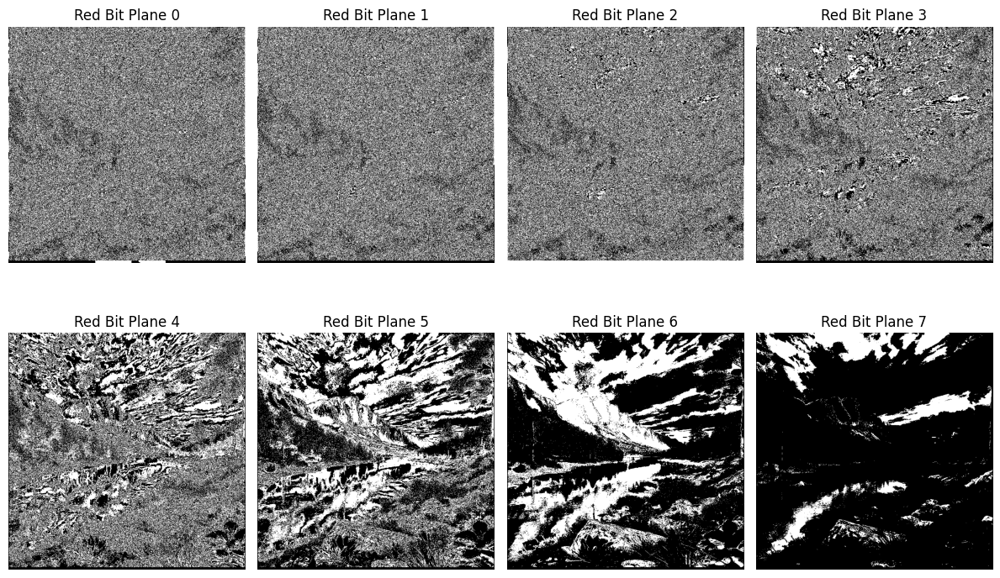

In [49]:
# Visualization of bit planes for the Red channel
plt.figure(figsize=(12, 8))
for i, bit_plane_bp in enumerate(bit_planes_bp[0]):  # Red channel (0)
    plt.subplot(2, 4, i + 1)
    plt.title(f"Red Bit Plane {i}")
    plt.imshow(bit_plane_bp, cmap="gray")
    plt.axis("off")
plt.tight_layout()
plt.show()

### **Compression: Discarding Least Significant Bit (LSB) planes:**

In [50]:
# Create a compressed image by retaining the 4 MSBs (bit planes 4 to 7)
compressed_image_bp = np.zeros_like(image, dtype=np.uint8)
for channel in range(3):  # R, G, B
    for bit in range(4, 8):  # Retain MSBs (4 to 7)
        compressed_image_bp[:, :, channel] += (bit_planes_bp[channel][bit] << bit)

In [51]:
# --- Decoding: Reconstruct the Image ---
decoded_image_bp = compressed_image_bp.copy()

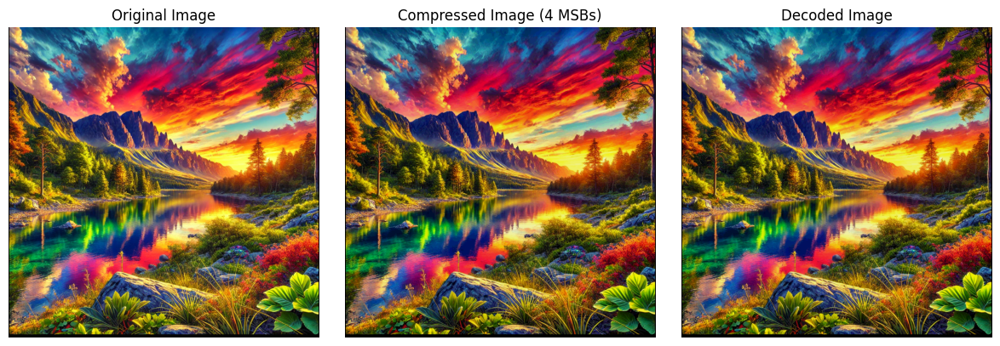

In [53]:
plt.figure(figsize=(12, 4))
# Original Image
plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
plt.axis("off")
# Compressed Image
plt.subplot(1, 3, 2)
plt.title("Compressed Image (4 MSBs)")
plt.imshow(cv2.cvtColor(compressed_image_bp, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
plt.axis("off")
# Decoded Image
plt.subplot(1, 3, 3)
plt.title("Decoded Image")
plt.imshow(cv2.cvtColor(decoded_image_bp, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
plt.axis("off")

plt.tight_layout()
plt.show()

In [70]:
if np.array_equal(image, decoded_image_bp):
    print("The decoded image is identical to the original image.")
else:
    print("The decoded image differs from the original image.")

The decoded image differs from the original image.


### **Original and Huffman compressed sizes Comparison:**

In [54]:
# Calculate original and compressed sizes (bit-plane coding)
original_size_bits_bp = height * width * channels * 8  # Original size in bits
compressed_size_bits_bp = height * width * channels * 4  # Only 4 MSB planes retained, so 4 bits per pixel per channel

# Convert sizes to bytes and kilobytes
original_size_bytes_bp = int(original_size_bits_bp / 8)
compressed_size_bytes_bp = int(compressed_size_bits_bp / 8)

original_size_kb_bp = original_size_bytes_bp / 1024
compressed_size_kb_bp = compressed_size_bytes_bp / 1024

In [55]:
# Print size results
print(f"Original Size (BP): {original_size_bits_bp} bits ({original_size_bytes_bp} bytes, {original_size_kb_bp:.2f} KB)")
print(f"Compressed Size (BP): {compressed_size_bits_bp} bits ({compressed_size_bytes_bp} bytes, {compressed_size_kb_bp:.2f} KB)")

Original Size (BP): 14845968 bits (1855746 bytes, 1812.25 KB)
Compressed Size (BP): 7422984 bits (927873 bytes, 906.13 KB)


### **Inference:**
- The original image size is 14845968 bits (1812.25 KB), which represents the full uncompressed data required to store the image.
- After applying Bit Plane Encoding (BP), the compressed size is 7422984 bits (906.13 KB), resulting in a reduction of approximately 50% in file size.
- The compression ratio is 0.5, which means that the compressed image is 50% of the original size, effectively halving the file sizrm.
- The 50% reduction in size indicates that Bit Plane Encoding has achieved substantial file size reduction, making it suitable for storage and transmission purposes without compromising image data (lossless compression).
- The compression of 50% demonstrates the efficiency of Bit Plane Encoding in reducing storage requirements while maintaining the integrity of the original image data.


### **Performance Metrics:**

In [56]:
compression_ratio_bp = compressed_size_bits_bp / original_size_bits_bp
compression_factor_bp = original_size_bits_bp / compressed_size_bits_bp

mse_bit_plane_bp = np.mean((image - decoded_image_bp) ** 2)

if mse_bit_plane_bp == 0:
    psnr_bit_plane_bp = float('inf')
else:
    psnr_bit_plane_bp = 10 * np.log10((255**2) / mse_bit_plane_bp)

In [57]:
print(f"Compression Ratio (BP): {compression_ratio_bp:.4f}")
print(f"Compression Factor (BP): {compression_factor_bp:.4f}")
print(f"MSE for Bit Plane Coding: {mse_bit_plane_bp:.4f}")
print(f"PSNR for Bit Plane Coding: {psnr_bit_plane_bp:.4f}")

Compression Ratio (BP): 0.5000
Compression Factor (BP): 2.0000
MSE for Bit Plane Coding: 76.8364
PSNR for Bit Plane Coding: 29.2751


### **Interpretation:**
- The compression ratio of 0.5 means that the compressed image is 50% of the size of the original image, indicating a 50% reduction in file size.
- The compression factor of 2.00 implies that the original image is compressed to half its size, resulting in a twofold reduction in storage space.
- The Mean Squared Error (MSE) value of 76.8364 indicates a moderate difference between the original and compressed images. Although the image is compressed, some level of distortion has occurred due to the compression process.
- The Peak Signal-to-Noise Ratio (PSNR) of 29.2751 dB suggests that the quality of the compressed image is still quite good, but with some noticeable loss of detail when compared to the original image. A PSNR value around 30 dB is often considered a reasonable balance between compression and visual quality.

### **Insights:**

- **Bit Plane Coding** has shown significant effectiveness in compressing the image, with a **50% reduction** in size, which demonstrates its ability to efficiently reduce storage requirements.
- Despite the size reduction, there is some **quality loss** as indicated by the **MSE = 76.8364** and a **PSNR of 29.2751 dB**, showing that while the compression maintains perceptible quality, it does introduce noticeable degradation.
- **Bit Plane Coding** is an efficient technique for **storage optimization** and **transmission speed improvement**, especially when a balance between compression and quality is acceptable.
- While the compression leads to some loss in image quality, the **compression ratio** of **0.5** and **compression factor** of **2.0** indicate a good trade-off between compression and quality for most general applications.


<h3 align="center" style="color:brown; font-size:200%; font-weight:bold;">Bit Plane Encoding</h3>

In [62]:
height, width, channels = image.shape
print("Image shape:", image.shape)

Image shape: (787, 786, 3)


In [63]:
bit_planes = {channel: [] for channel in range(3)}  # Store bit planes for each channel (R, G, B)
for channel in range(3):  # Loop through R, G, and B channels
    for bit in range(8):  # Extract 8 bit planes for each channel
        bit_plane = (image[:, :, channel] >> bit) & 1
        bit_planes[channel].append(bit_plane)

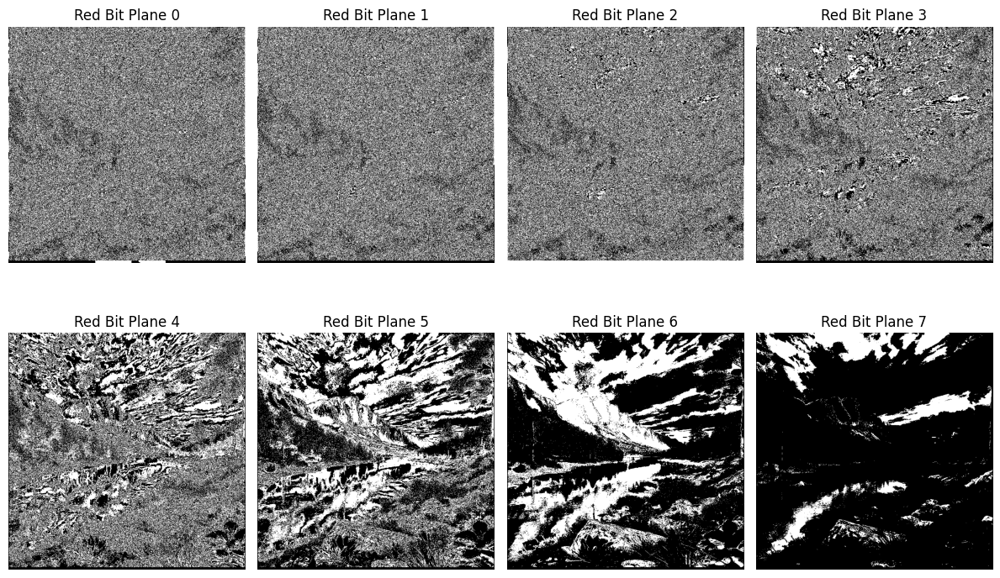

In [64]:
plt.figure(figsize=(12, 8))
for i, bit_plane in enumerate(bit_planes[0]):  # Red channel (0)
    plt.subplot(2, 4, i + 1)
    plt.title(f"Red Bit Plane {i}")
    plt.imshow(bit_plane, cmap="gray")
    plt.axis("off")
plt.tight_layout()
plt.show()

### **Inference:**
1. **Lower Bit Planes (0-3) - Fine Details and Noise:**
   - The lower bit planes capture high-frequency information, such as fine details and noise.
   - These planes have subtle changes in pixel values that don't significantly affect the overall image appearance.
   - In image compression, these planes are given lower priority, as removing or reducing them results in minimal perceptual loss.

2. **Middle Bit Planes (4-6) - Intermediate Features and Texture:**
   - The middle bit planes hold moderate-frequency components, representing features like edges, textures, and subtle variations in color.
   - These planes play a crucial role in defining the sharpness and detail of the image.
   - Compression algorithms preserve these planes more than the lower ones, as they significantly affect the image's appearance, especially texture and edge definition.

3. **Highest Bit Plane (7) - Major Visual Information:**
   - The highest bit plane contains the most significant visual data, such as overall brightness, contrast, and dominant color information.
   - This plane has the most substantial impact on the image’s visual appearance.
   - Retaining this bit plane is essential to maintaining the overall quality and perceptual integrity of the image.

In [65]:
compressed_image_bf = np.zeros_like(image, dtype=np.uint8)
for channel in range(3):  # R, G, B
    for bit in range(4, 8):  # Retain MSBs (4 to 7)
        compressed_image_bf[:, :, channel] += (bit_planes[channel][bit] << bit)

# Step 4: Decoding (No change here, just reconstructing the image)
decoded_image_bf = compressed_image_bf.copy()

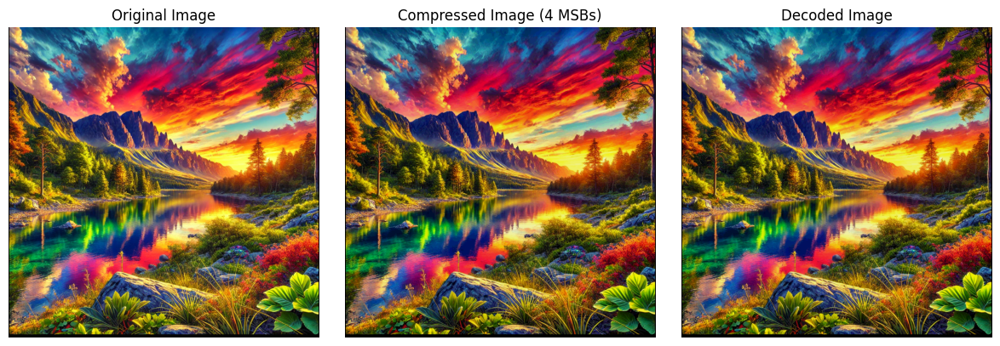

In [66]:
plt.figure(figsize=(12, 4))
plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
plt.axis("off")
plt.subplot(1, 3, 2)
plt.title("Compressed Image (4 MSBs)")
plt.imshow(cv2.cvtColor(compressed_image_bf, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
plt.axis("off")
plt.subplot(1, 3, 3)
plt.title("Decoded Image")
plt.imshow(cv2.cvtColor(decoded_image_bf, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
plt.axis("off")

plt.tight_layout()
plt.show()


### **Original and bit plane encoding compressed sizes Comparison:**

In [67]:
original_size_bits = height * width * channels * 8  # Original size in bits
compressed_size_bits = height * width * channels * 4  # Only 4 MSB planes retained, so 4 bits per pixel per channel

original_size_bytes = int(original_size_bits / 8)
compressed_size_bytes = int(compressed_size_bits / 8)

original_size_kb = original_size_bytes / 1024
compressed_size_kb = compressed_size_bytes / 1024

print(f"Original Size: {original_size_bits} bits ({original_size_bytes} bytes, {original_size_kb:.2f} KB)")
print(f"Compressed Size: {compressed_size_bits} bits ({compressed_size_bytes} bytes, {compressed_size_kb:.2f} KB)")

Original Size: 14845968 bits (1855746 bytes, 1812.25 KB)
Compressed Size: 7422984 bits (927873 bytes, 906.13 KB)


### **Inference:**
- The original image size is 14845968 bits (1812.25 KB), which represents the uncompressed version of the image.
- After compression, the size reduces to 7422984 bits (906.13 KB), indicating a significant reduction in file size.
- The compression effectively reduces the file size by approximately 50%, making the image more suitable for storage or transmission with minimal data usage.


### **Performance Metrics:**

In [68]:
compression_ratio = compressed_size_bits / original_size_bits
compression_factor = original_size_bits / compressed_size_bits

mse_bit_plane = np.mean((image - decoded_image_bf) ** 2)

if mse_bit_plane == 0:
    psnr_bit_plane = float('inf')
else:
    psnr_bit_plane = 10 * np.log10((255**2) / mse_bit_plane)
print(f"Compression Ratio: {compression_ratio:.4f}")
print(f"Compression Factor: {compression_factor:.4f}")
print(f"MSE for Bit Plane Coding: {mse_bit_plane:.4f}")
print(f"PSNR for Bit Plane Coding: {psnr_bit_plane:.4f}")

Compression Ratio: 0.5000
Compression Factor: 2.0000
MSE for Bit Plane Coding: 76.8364
PSNR for Bit Plane Coding: 29.2751


## **Interpretation:**
- The compression ratio of 0.5000 indicates that the compressed image size is 50% of the original size, showing a reduction in file size.
- The compression factor of 2.0000 means the original image is twice as large as the compressed version, reflecting significant file size reduction.
- The MSE of 76.8364 suggests a noticeable loss of quality, as higher MSE values indicate more distortion between the original and compressed images.
- The PSNR value of 29.2751 dB indicates a reasonable level of image quality, though not perfect, suggesting some visible degradation after compression.


## **Insights:**
- Bit Plane Encoding effectively reduces the image file size by focusing on the most significant bits, which contribute the most to the image's visual quality. 
- This technique is efficient for storage and transmission, achieving significant size reduction without compromising essential visual details, making it ideal for applications with limited bandwidth or storage.
- Despite its effectiveness, Bit Plane Encoding has limitations, particularly in handling images with fine details or high-frequency content. It may not achieve the same compression ratios as other methods like JPEG or Huffman coding for such images.


## **Insights:**
The ranking depends on the application requirements. Huffman Coding leads for precision, RLE excels with patterns, and Bit Plane Coding balances size reduction and perceptual quality in lossy contexts.

### **Conclusion**

The study highlights the importance of selecting the appropriate image compression technique based on the specific requirements of the application. **Lossless methods** such as RLE and Huffman Coding are ideal for scenarios where quality preservation is critical, whereas **lossy techniques** like JPEG offer significant size reduction at the cost of minor quality degradation. 
The comparative analysis demonstrates that no single method is universally superior; instead, the choice depends on factors like storage constraints, computational efficiency, and acceptable quality loss. The performance metrics provide a quantitative basis for decision-making, ensuring that compression goals align with practical needs.This report concludes that an informed trade-off between compression efficiency and image quality is essential for achieving optimal results.
